In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd /content/drive/MyDrive/dataset

/content/drive/MyDrive/dataset


In [ ]:
# !unzip test_v2.zip

In [ ]:
# !unzip train_v2.zip

#Import Tensorflow and other Libraries

In [4]:
import tensorflow as tf

import matplotlib.pyplot as plt

import numpy as np

from IPython import display

#Load The Dataset

show a sample image of dataset

TensorShape([558, 1116, 3])

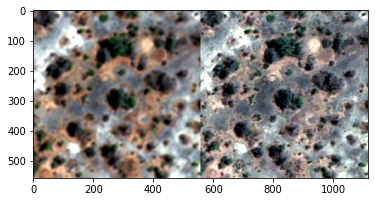

In [5]:
sample = tf.io.read_file('train/20.jpg')
sample = tf.image.decode_jpeg(sample)

plt.imshow(sample)
sample.shape

**because the limitation of structure of dataset, we consider the 2D input instead of 3D**

shape of training and tet dataset

In [6]:
train_dataset = tf.data.Dataset.list_files(file_pattern=str('train/*.jpg'), shuffle=True)
print('size of training: {}'.format(len(train_dataset)))

test_dataset = tf.data.Dataset.list_files(file_pattern=str('test/*.jpg'), shuffle=True)
print('size of test: {}'.format(len(test_dataset)))


size of training: 51
size of test: 12


functions to do preprocess on data

In [7]:
WIDTH = 128
HEIGHT = 128

BUFFER_SIZE = 100
BATCH_SIZE = 1

In [8]:
from tensorflow.keras.layers.experimental import preprocessing

trainAug = tf.keras.Sequential([
  # random shift 
  preprocessing.RandomTranslation(height_factor=(-0.1,0.1), width_factor=(-0.1,0.1), fill_mode='constant', fill_value=0.0),
	# random rotation
  preprocessing.RandomRotation(factor=(-0.02,0.02), fill_mode='constant', fill_value=0.0),
	# random contrast
  # preprocessing.RandomContrast(factor=0.1)
  # preprocessing.RandomFlip("horizontal_and_vertical"),
])

In [11]:

def load(image_file):
  # image = load_img(image_file, target_size = (HEIGHT, 2*WIDTH))
  image = tf.io.read_file(image_file)
  image = tf.image.decode_jpeg(image)

  

  # split data 
  w = tf.shape(image)[1]//2
  x_image, y_image = image[:,:w,:], image[:, w:, :]
  y_image = tf.cast(y_image, tf.float32)
  x_image = tf.cast(x_image, tf.float32)

  # resize image to to 128x128
  y_image = tf.image.resize(images=y_image, size=[HEIGHT, WIDTH], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  x_image = tf.image.resize(images=x_image, size=[HEIGHT, WIDTH], method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  # print(x_image.shape)

  return  x_image, y_image 

# Normalizing the images to [-1, 1]
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

def load_image_train(image_file):
  x_image, y_image  = load(image_file)

  # x_image = trainAug(tf.reshape(x_image, (1, WIDTH, HEIGHT, 3)))[0]
  # y_image = tf.reshape(y_image, (1, WIDTH, HEIGHT, 3))

  x_image, y_image = normalize(x_image, y_image)

  return x_image, y_image


def load_image_test(image_file):
  x_image, y_image = load(image_file)
  x_image, y_image = normalize(x_image, y_image)

  return  x_image, y_image

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


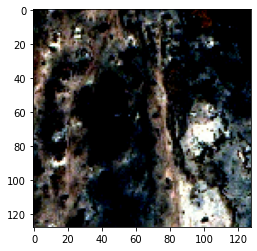

In [12]:
x, y = load_image_test('train/13.jpg')
plt.imshow(y)

In [13]:
train_images = train_dataset.map(map_func=load_image_train, num_parallel_calls=tf.data.AUTOTUNE).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

test_images = test_dataset.map(map_func=load_image_test).batch(BATCH_SIZE)


**convert tf.data.dataset to numpy array**

In [14]:
# type(train_images)

In [15]:
# train_set = np.array(list(train_images.as_numpy_iterator()))
# test_set = np.array(list(test_images.as_numpy_iterator()))

In [16]:
# x_train = train_set[:, 0, 0, :, :, :]
# y_train = train_set[:, 1, 0, :, :, :]

# x_train.shape

In [17]:
# datagen = ImageDataGenerator(rotation_range=90)
# datagen.flow(x=x_train, y=y_train, batch_size=32)

In [18]:
type(train_images)

tensorflow.python.data.ops.dataset_ops.BatchDataset

**check kind of data augmentation on sample**

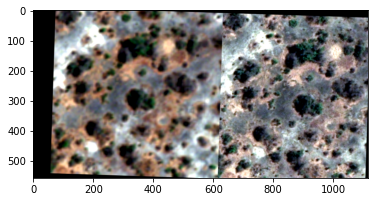

In [19]:
sample_aug = tf.expand_dims(sample, 0)
# plt.imshow(sample)
# plt.figure(figsize=(10, 10))
augmented_image = trainAug(sample_aug)

for im in augmented_image:
  plt.imshow(im)
  # plt.axis("off")

# Build the model (GAN)

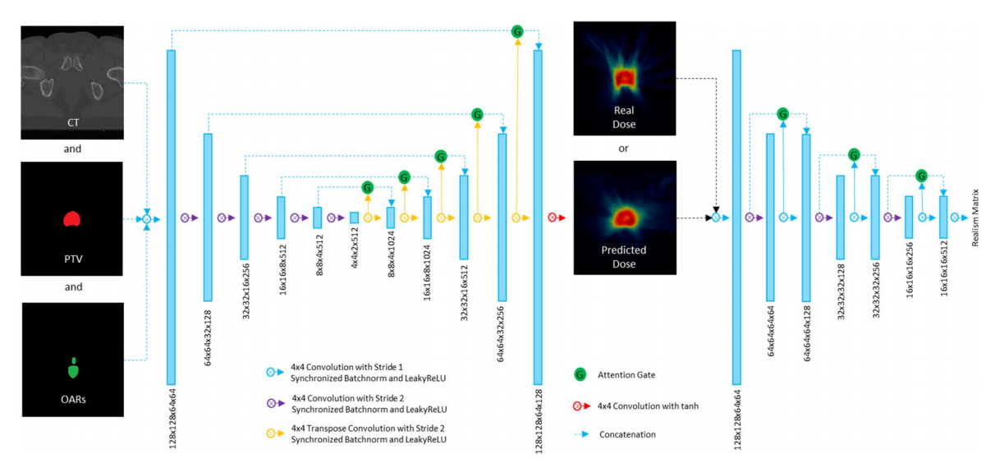

##Generator

In [20]:
from keras.layers import Conv2D, BatchNormalization, LeakyReLU, Conv2DTranspose, Dropout
from keras.layers import *

U-Net architecture

In [21]:
OUTPUT_CHANNELS = 3

In [22]:
def downsample(filters, size, apply_batchnorm=True, strides=2):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=strides, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [23]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(x, 0))
print (down_result.shape)

(1, 64, 64, 3)


In [24]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))
  
  result.add(LeakyReLU())

  return result

In [25]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

(1, 128, 128, 3)


**attention gate**

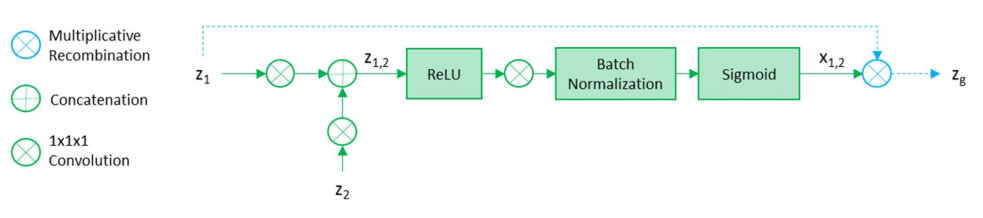

In [26]:
class AttentionGate(tf.keras.layers.Layer):
    def __init__(self, n_kernel):
        super(AttentionGate, self).__init__()
        initializer = tf.random_normal_initializer(0., 0.02)
        
        self.n_kernel = n_kernel

        self.conv_x = Conv2D(filters=self.n_kernel, kernel_size=1, padding='same', strides=1, kernel_initializer=initializer)
        
        initializer = tf.random_normal_initializer(0., 0.02)
        self.conv_g = Conv2D(filters=self.n_kernel, kernel_size=1, strides=1, padding='same', kernel_initializer=initializer)

        initializer = tf.random_normal_initializer(0., 0.02)
        self.conv_out = Conv2D(filters=1, kernel_size=1, strides=1, padding='same',  kernel_initializer=initializer)
    
        self.batchNormal = BatchNormalization()


    def call(self,  inputs):
      current = inputs[0]
      down_layer = inputs[1]
      
      tensor_current = self.conv_x(current)

      tensor_down_layer = self.conv_g(down_layer)

      # add together
      tensor_added = add([tensor_down_layer, tensor_current])
      tensor_added = Activation('relu')(tensor_added)

      # conv 1x1
      tensor_conv = self.conv_out(tensor_added)

      # batch normalization
      tensor_batch = self.batchNormal(tensor_conv)

      # relu
      tensor = Activation('sigmoid')(tensor_batch)

      wighted_tensor = tf.repeat(tensor, repeats=self.n_kernel, axis=3)

      # multiply
      out = multiply([wighted_tensor, tensor_current])

      return out

In [27]:
def attentionGate(current, down_layer, inter_shape):
  # inter_shape = 512
  tensor_current = Conv2D(filters=inter_shape, kernel_size=1, padding='same', strides=1,)(current)

  tensor_down_layer = Conv2D(filters=inter_shape, kernel_size=1, strides=1, padding='same')(down_layer)

  # add together
  tensor_added = add([tensor_down_layer, tensor_current])
  tensor_added = Activation('relu')(tensor_added)

  # conv 1x1
  tensor_conv = Conv2D(filters=1, kernel_size=1, strides=1, padding='same')(tensor_added)

  # batch normalization
  tensor_batch = BatchNormalization()(tensor_conv)

  # relu
  tensor = Activation('sigmoid')(tensor_batch)

  wighted_tensor = tf.repeat(tensor, repeats=inter_shape, axis=3)

  # multiply
  out = multiply([wighted_tensor, tensor_current])

  return out

In [28]:
att_result = attentionGate(up_result, tf.expand_dims(x, 0), 3)
print(att_result.shape)

(1, 128, 128, 3)


In [29]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[HEIGHT, WIDTH, 3])

  down_stack = [
    downsample(64, 4, strides=1),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=1,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)
                                         

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    # print(x.shape)
    # print(skip.shape)
    # print(tf.shape(x)[3])

    att_x = AttentionGate(n_kernel=x.shape[3])([x, skip])

    # x = tf.keras.layers.Concatenate()([x, skip])

    # print('hi')

    
    

    x = Concatenate()([x, att_x])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

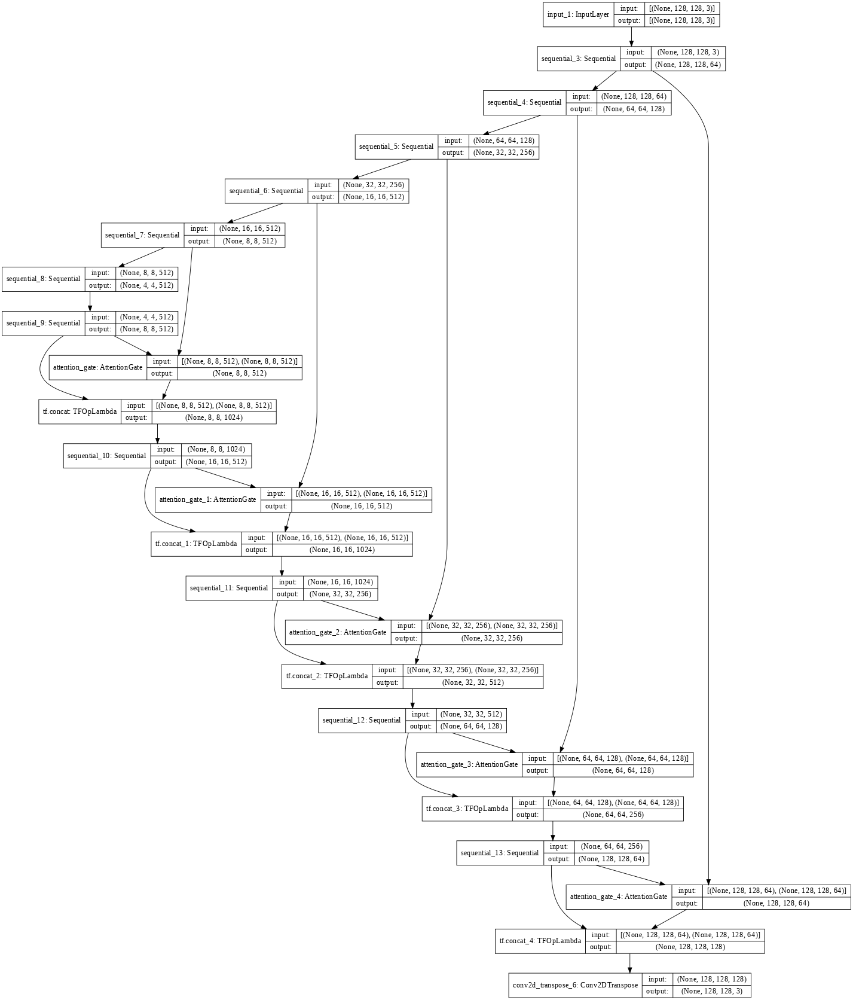

In [30]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

**generator loss**

In [31]:
# based on pix2pix article
LAMBDA = 100

In [32]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [33]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

# Discriminator

In [34]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[HEIGHT, WIDTH, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[HEIGHT, WIDTH, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, strides=1)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(64, 4, strides=2)(down1)  # (batch_size, 128, 128, 64)

  temp_down3 = downsample(64, 4, strides=1)(down2)  # (batch_size, 64, 64, 128)
  skip1 = AttentionGate(n_kernel=temp_down3.shape[3])([temp_down3, down2])
  down3 = Concatenate()([temp_down3, skip1])

  down4 = downsample(128, 4, strides=2)(down3)

  temp_down5 = downsample(128, 4, strides=1)(down4)
  skip2 = AttentionGate(n_kernel=temp_down5.shape[3])([temp_down5, down4])
  down5 = Concatenate()([temp_down5, skip2])

  down6 = downsample(256, 4, strides=2)(down5)

  temp_down7 = downsample(256, 4, strides=1)(down6)
  skip3 = AttentionGate(n_kernel=temp_down7.shape[3])([temp_down7, down6])
  down7 = Concatenate()([temp_down7, skip3])


  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down7)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

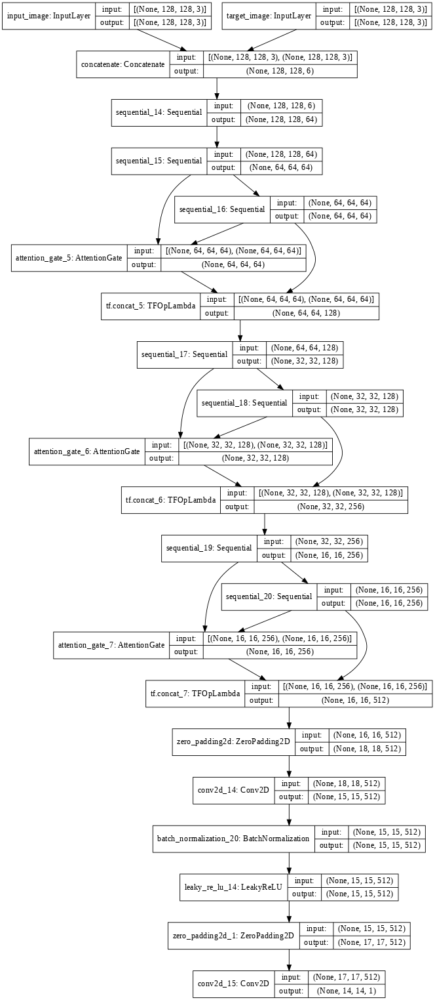

In [35]:
discriminator = Discriminator() 
# discriminator.summary()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

**discriminator loss**

In [36]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

#Train the model

In [37]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [38]:
import os
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [39]:
def save_image(model, test_input, tar):
  prediction = model(test_input, training=True)

  fig, axes = plt.subplots(ncols=2, nrows=1, figsize=(20, 20))
  # axes.axis("off")
  input = stretch(prediction[0])
  axes[0].imshow(input)
  axes[0].axis("off")
  axes[0].set_xticklabels([])
  target = stretch(tar[0])
  axes[1].imshow(target)
  axes[1].axis("off")
  axes[1].set_xticklabels([])
  fig.subplots_adjust(wspace=0, hspace=0)
  fig.savefig('{}.jpg'.format(i),bbox_inches='tight',pad_inches = 0)
  plt.show()

In [40]:
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [41]:
import datetime
import time
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [42]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

In [43]:
def fit(train_ds, test_ds, steps):
  example_input, example_target = next(iter(test_ds.take(1)))

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      start = time.time()
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start} sec\n')

      generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")

    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

In [44]:
%load_ext tensorboard
%tensorboard --logdir {log_dir}

<IPython.core.display.Javascript object>

Time taken for 1000 steps: 0.002036571502685547 sec



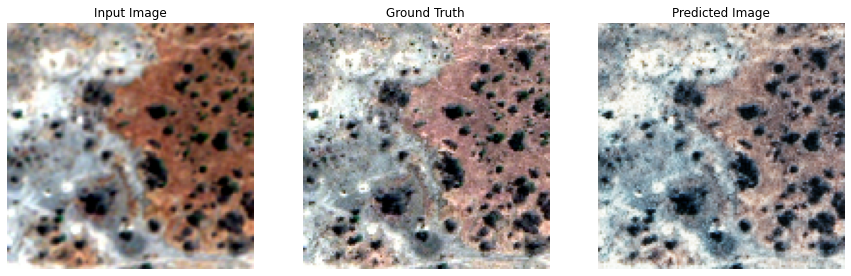

Step: 39k
....................................................................................................

In [45]:
fit(train_images, test_images, steps=40000)

In [46]:
tensorboard dev upload --logdir {log_dir}

ERROR: Failed to launch TensorBoard (exited with 1).
Contents of stderr:
2021-07-14 17:22:07.479691: I tensorflow/stream_executor/platform/default/dso_loader.cc:53] Successfully opened dynamic library libcudart.so.11.0

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

logs/

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Traceback (most recent call last):
  File "/usr/local/bin/tensorboard", line 8, in <module>
    sys.exit(run_main())
  File "/usr/local/lib/python3.7/dist-packages/tensorboard/main.py", line 46, in ru

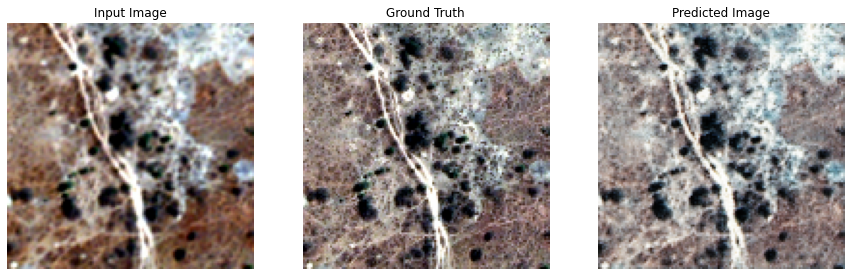

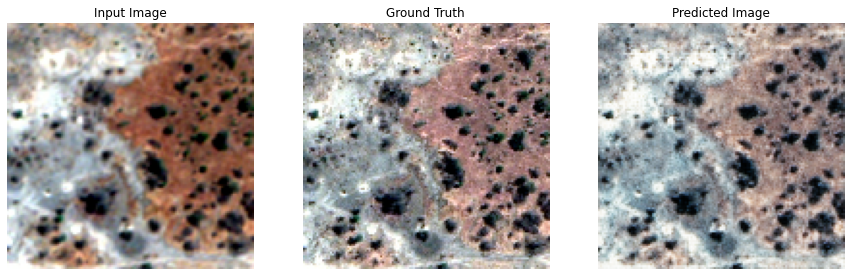

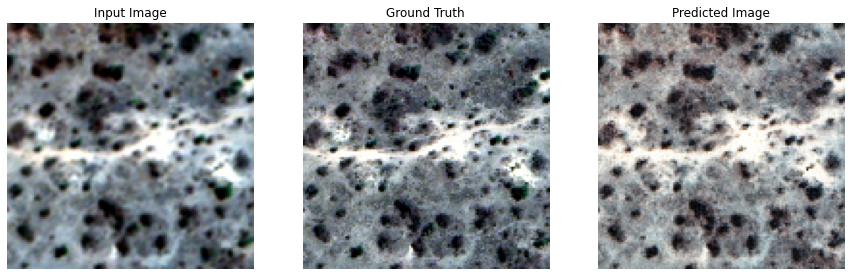

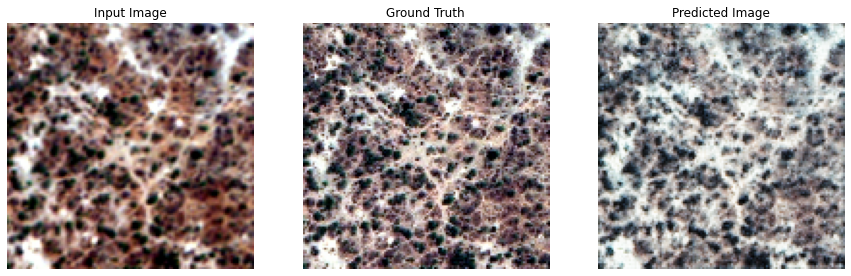

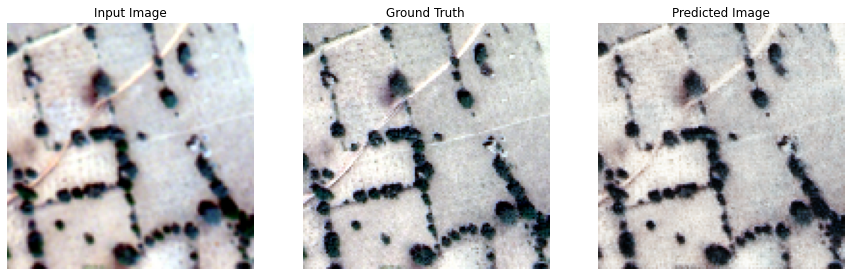

...

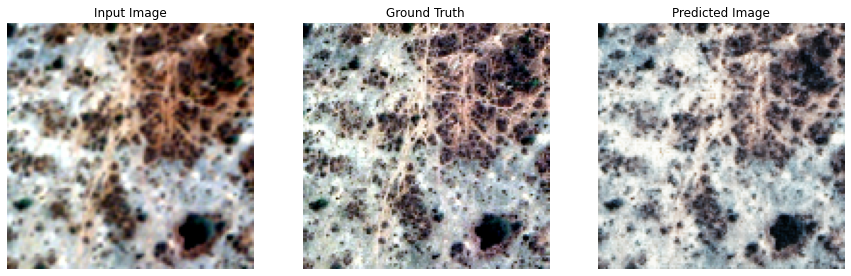

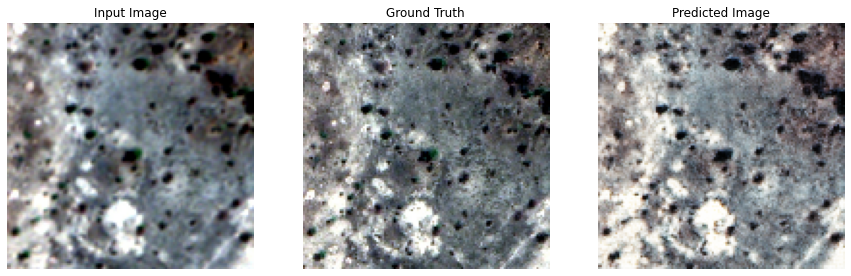

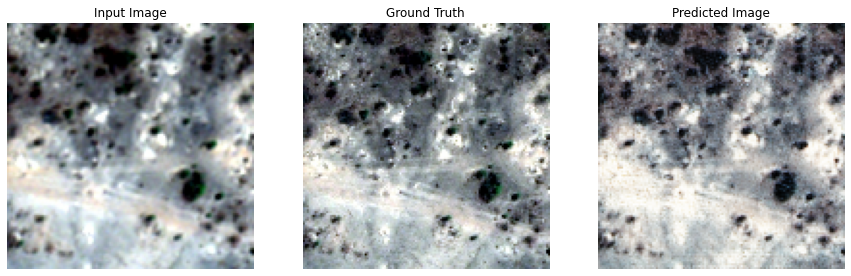

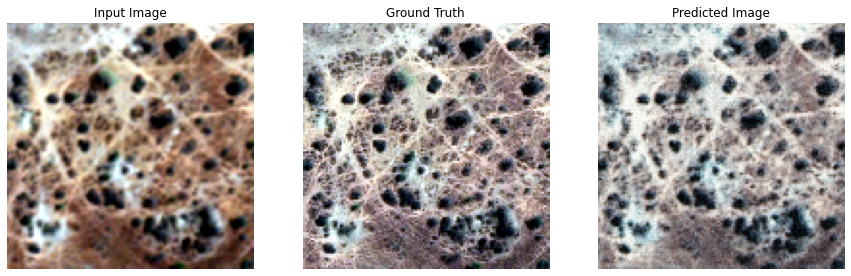

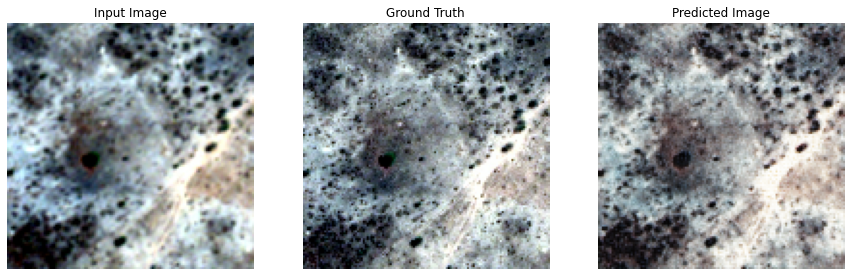

In [49]:
# Run the trained model on a few examples from the test set
for inp, tar in test_images.take(80):
  generate_images(generator, inp, tar)